# Домашнее задание № 0
Вам необходимо провести анализ данных и с помощью него ответить на поставленные вопросы. 

# Исходные данные
Этот набор данных представляет собой описание около 1 миллиона треков с платформы Spotify. Скачайте датасет и ознакомьтесь с описанием данных в [источнике](https://www.kaggle.com/datasets/amitanshjoshi/spotify-1million-tracks/data).

In [1]:
import pandas as pd

In [2]:
# Читаем данные
path = 'data.csv'
df = pd.read_csv(path, index_col=0)

In [3]:
df.sample(3).T

,580317,1255372,524320
artist_name,Josh Levi,Amaral,Nina June
track_name,ALL OVER AGAIN,El artista del alambre,Rainbow Ashes
track_id,3LpbHOkTRZ0ls06L0xKdpH,5fXl4U5bbMAf5UWdY61LeY,1WTDSw85vs3HAkOkyoADq7
popularity,53,28,54
year,2022,2008,2021
genre,soul,spanish,singer-songwriter
danceability,0.63,0.568,0.41
energy,0.594,0.53,0.368
key,2,10,10
loudness,-6.938,-6.296,-9.515


# Вопросы

## Анализ данных
С помощью работы с типом данных DataFrame из библиотеки pandas ответье на поставленные вопросы

In [4]:
# YOUR IMPORTS HERE

### 1. Сколько уникальных исполнителей и сколько уникальных жанров содержится в датасете?

**Результат**: Код и текстовый ответ на вопрос в формате

```
Уникальных исполнителей: <ответ>
Уникальных жанров: <ответ>
```

In [5]:
unique_artists = df['artist_name'].nunique()
unique_genres = df['genre'].nunique()

print(f"Уникальных исполнителей: {unique_artists}")
print(f"Уникальных жанров: {unique_genres}")

Уникальных исполнителей: 64158
Уникальных жанров: 82


### 2. Есть ли в данных пропуски? Если да, предложите способ их заполнения и реализуйте его

**Результат**: Код и текстовый ответ на вопрос в формате

```
Для каждого столбца в таблице
<Название столбца> - <Сколько пропусков> - <Описание способа заполнения> (Если были пропуски)
```


In [6]:
missing_values = df.isnull().sum()
result_df = pd.DataFrame({'Название столбца': missing_values.index,
                         'Число пропусков': missing_values.values,
                         'Способ заполнения': missing_values.apply(lambda x: 'Filled with "Unknown"' if x > 0 else 'No missing values')})

df = df.fillna("Unknown")
result_df

,Название столбца,Число пропусков,Способ заполнения
artist_name,artist_name,15,"Filled with ""Unknown"""
track_name,track_name,1,"Filled with ""Unknown"""
track_id,track_id,0,No missing values
popularity,popularity,0,No missing values
year,year,0,No missing values
genre,genre,0,No missing values
danceability,danceability,0,No missing values
energy,energy,0,No missing values
key,key,0,No missing values
loudness,loudness,0,No missing values


### 3. Есть ли признаки, которые не отвечают указанным в описании ограничениям? Если есть, то замените их

**Результат**: Код и текстовый ответ на вопрос в формате

```
Для каждого столбца в таблице
<Название столбца> - <Сколько не соответствующих ограничениям данных> - <Описание способа замены> (Если были некорректные данные)
```

<img src=restrictions.png style="width: 500px;"></img>

In [7]:
constraints = {
    'popularity': (0, 100),
    'year': (2000, 2023),
    'danceability': (0.0, 1.0),
    'energy': (0.0, 1.0),
    'key': (-1, 11),
    'loudness': (-60, 0),
    'mode': (0, 1),
    'speechiness': (0, 1),
    'acousticness': (0, 1),
    'instrumentalness': (0.0, 1.0),
    'liveness': (0.0, 1.0),
    'valence': (0.0, 1.0),
    'tempo': (0, None),
    'time_signature': (3, 7),
    'duration_ms': (0, None),
}

result = []
for column, bounds in constraints.items():
    count_incorrect = 0
    if bounds[1] is not None:
        if column == "mode":
            count_incorrect += df.loc[(df[column] != bounds[0]) & (df[column] != bounds[1])].shape[0]
        else:
            count_incorrect += df.loc[(df[column] < bounds[0]) | (df[column] > bounds[1])].shape[0]
    else:
        count_incorrect += df.loc[df[column] < bounds[0]].shape[0]
    
    result.append([column, count_incorrect, 'will be resolved' if count_incorrect else 'Restrictions are met'])


result_df = pd.DataFrame(result, columns=["Название столбца", "Число некорректных данных", "Способ замены"])

### There only loudness and time_signature are with incorrect data, so we will be working only with them

mean_loudness = df['loudness'][df['loudness'].between(-60, 0)].mean()
df['loudness'] = df['loudness'].apply(lambda x: mean_loudness if x < -60 or x > 0 else x)
row_index = result_df.index[result_df["Название столбца"] == "loudness"][0]
result_df.loc[row_index, "Способ замены"] = "Resolved by replacing with the mean value in ddesired range (-60, 0)"

# most_frequent_time_signature = df['time_signature'].mode()[0]
most_frequent_time_signature = df['time_signature'][df['time_signature'].between(3, 7)].mode()[0]
df['time_signature'] = df['time_signature'].apply(lambda x: most_frequent_time_signature if x > 7 or x < 3 else x) # replace with the mode
row_index = result_df.index[result_df["Название столбца"] == "time_signature"][0]
result_df.loc[row_index, "Способ замены"] = "Resolved by replacing with the mode"

result_df

,Название столбца,Число некорректных данных,Способ замены
0,popularity,0,Restrictions are met
1,year,0,Restrictions are met
2,danceability,0,Restrictions are met
3,energy,0,Restrictions are met
4,key,0,Restrictions are met
5,loudness,1198,Resolved by replacing with the mean value in d...
6,mode,0,Restrictions are met
7,speechiness,0,Restrictions are met
8,acousticness,0,Restrictions are met
9,instrumentalness,0,Restrictions are met


## Визуальный анализ
Ответом на вопрос должен быть график или несколько графиков в одной фигуре (картинке), с минимальной подписью

In [8]:
import numpy as np

import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff

from plotly.subplots import make_subplots
from scipy.stats import multivariate_normal

### 1. Как Energy зависит от Danceability? Как зависит Loudness от Energy? Как эти параметры влияют на Valence?

**Результат**: Код, реализующий графики:

- Зависимость Energy от Danceability
- Зависимость Loudness от Energy
- Зависимость Valence от Energy, зависимость Valence от Danceability; в одной оси фигуры
- Зависимость Valence от Loudness
- Матрица корреляции Energy, Danceability, Loudness, Valence

Каждый график должен иметь название, подписанные оси и, при необходимости, легенду.

**Дополнительно**: Нарисовать стрелки и подписи к ним на графике, обращающие внимание на ключевые моменты, позволяющие сделать выводы о зависимостях. 

In [9]:
sample_df = df.sample(frac = 0.005)

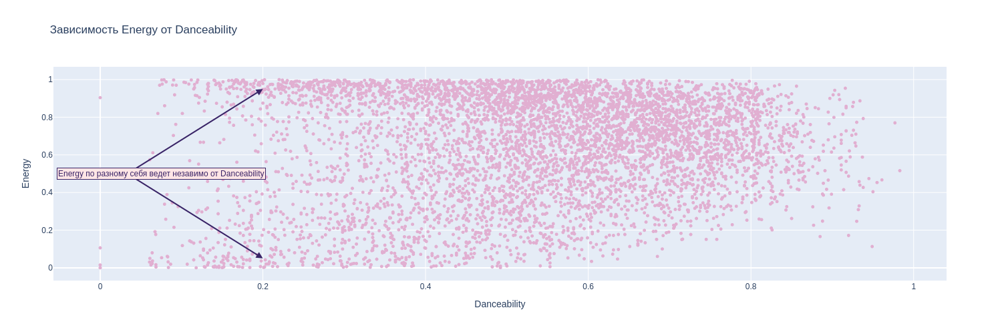

In [10]:
# 1. Зависимость Energy от Danceability
fig1 = px.scatter(sample_df, x="danceability", y="energy",
                  title="Зависимость Energy от Danceability",
                  labels={"danceability": "Danceability", "energy": "Energy"})
fig1.update_traces(marker=dict(size=5, color="#E1AFD1"))

# Add the first arrow
fig1.add_annotation(x=0.2, y=0.05, xref="x", yref="y", showarrow=True, arrowhead=2, arrowsize=1, arrowwidth=2, arrowcolor="#392467", ax=-200, ay=-125,)

# Add the second arrow
fig1.add_annotation(x=0.2, y=0.95, xref="x", yref="y", showarrow=True, arrowhead=2, arrowsize=1, arrowwidth=2, arrowcolor="#392467", ax=-200, ay=125,)

# Add text
fig1.add_annotation(
    x=0.075,
    y=0.5,
    xref="x",
    yref="y",
    showarrow=False,
    text="Energy по разному себя ведет незавимо от Danceability",
    font=dict(color="#392467"),
    bgcolor="#FFE6E6",
    bordercolor="#392467"
)

fig1.update_layout(height=500, width=1500,)
fig1.show()

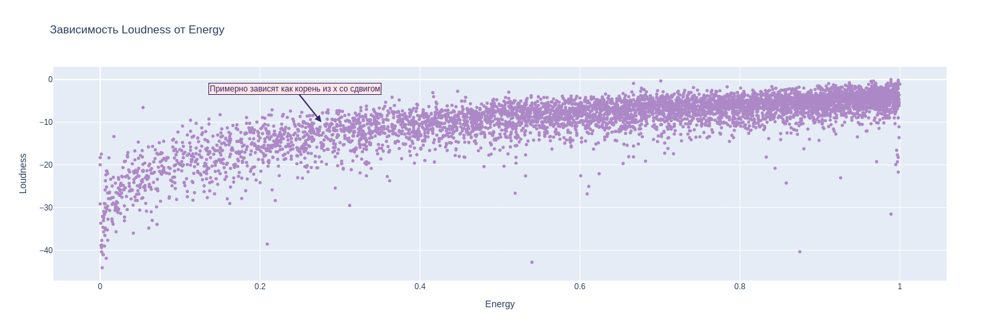

In [11]:
# 2. Зависимость Loudness от Energy
fig2 = px.scatter(sample_df, x="energy", y="loudness",
                  title="Зависимость Loudness от Energy",
                  labels={"energy": "Energy", "loudness": "Loudness"})
fig2.update_traces(marker=dict(size=5, color="#AD88C6"))
fig2.update_layout(height=500, width=1500,)
fig2.add_annotation(
    x=0.3,
    y=-10,
    xref="paper",
    yref="y",
    text="Примерно зависят как корень из х со сдвигом",
    showarrow=True,
    arrowhead=2,
    arrowsize=1,
    arrowwidth=2,
    arrowcolor="#392467",
    bgcolor="#FFE6E6",
    bordercolor="#392467",
    font=dict(color="#392467"),
    ax=-40,
    ay=-50
    
)
fig2.show()

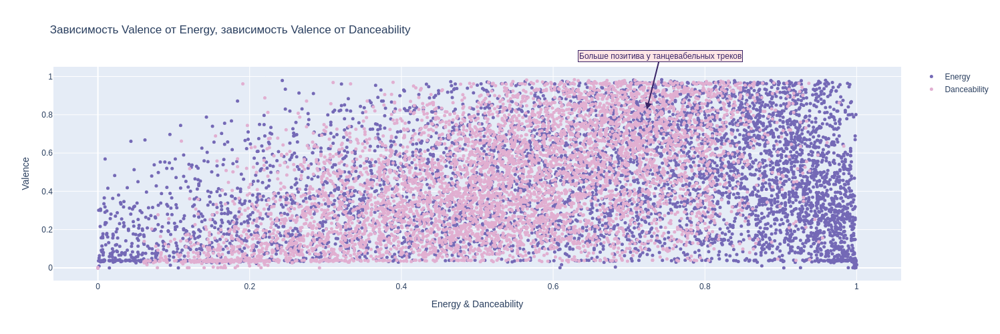

In [12]:
# 3. Зависимость Valence от Energy и Danceability
trace1 = go.Scatter(x=sample_df['energy'], y=sample_df['valence'], mode='markers', name='Energy',
                        marker=dict(size=5, color="#7469B6"))
trace2 = go.Scatter(x=sample_df['danceability'], y=sample_df['valence'], mode='markers', name='Danceability',
                        marker=dict(size=5, color="#E1AFD1"))
fig3 = go.Figure(data=[trace1, trace2])
fig3.update_layout(title="Зависимость Valence от Energy, зависимость Valence от Danceability",
                  xaxis_title="Energy & Danceability", yaxis_title="Valence",
                  showlegend=True, height=500, width=1500,)
fig3.add_annotation(
    x=0.7,
    y=0.8,
    xref="paper",
    yref="paper",
    text="Больше позитива у танцевабельных треков",
    showarrow=True,
    arrowhead=2,
    arrowsize=1,
    arrowwidth=2,
    arrowcolor="#392467",
    bgcolor="#FFE6E6",
    bordercolor="#392467",
    font=dict(color="#392467"),
    ax=20,
    ay=-80
    
)
fig3.show()

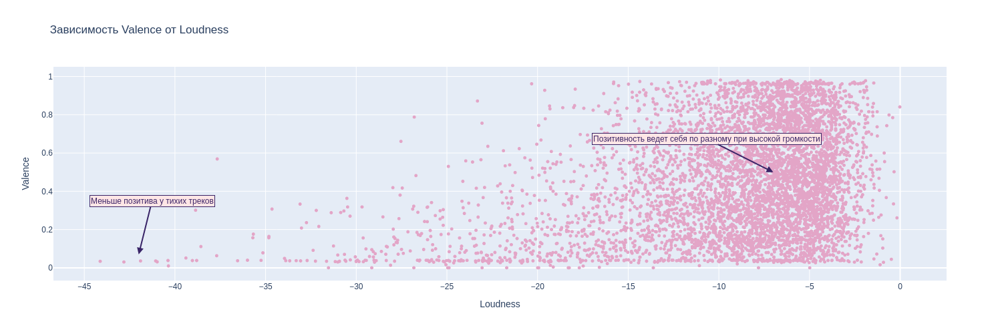

In [13]:
# 4. Зависимость Valence от Loudness
fig4 = px.scatter(sample_df, x="loudness", y="valence",
                  title="Зависимость Valence от Loudness",
                  labels={"loudness": "Loudness", "valence": "Valence"})
fig4.update_traces(marker=dict(size=5, color="#E3A5C7"))
fig4.update_layout(height=500, width=1500,)
fig4.add_annotation(
    x=-42,
    y=0.07,
    xref="x",
    yref="y",
    text="Меньше позитива у тихих треков",
    showarrow=True,
    arrowhead=2,
    arrowsize=1,
    arrowwidth=2,
    arrowcolor="#392467",
    bgcolor="#FFE6E6",
    bordercolor="#392467",
    font=dict(color="#392467"),
    ax=20,
    ay=-80
)
fig4.add_annotation(
    x=-7,
    y=0.5,
    xref="x",
    yref="y",
    text="Позитивность ведет себя по разному при высокой громкости",
    showarrow=True,
    arrowhead=2,
    arrowsize=1,
    arrowwidth=2,
    arrowcolor="#392467",
    bgcolor="#FFE6E6",
    bordercolor="#392467",
    font=dict(color="#392467"),
    ax=-100,
    ay=-50
)
fig4.show()

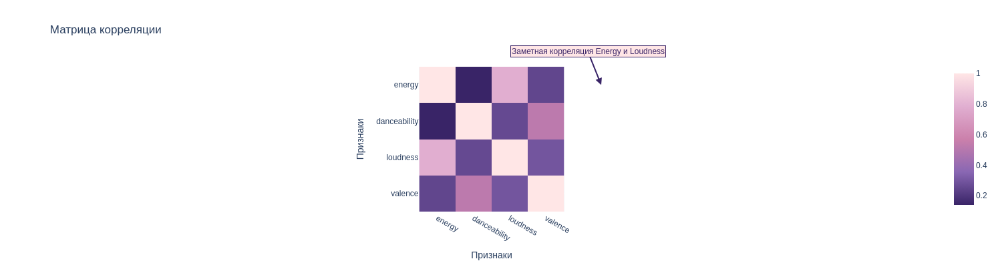

In [14]:
# 5. Матрица корреляции
corr_matrix = df[['energy', 'danceability', 'loudness', 'valence']].corr()
custom_colorscale = [
    [0, "#392467"],
    [0.25, "#8967B3"],
    [0.5, "#CB80AB"],
    [0.75, "#E1AFD1"],
    [1, "#FFE6E6"]
]
fig5 = px.imshow(corr_matrix,
                 title="Матрица корреляции",
                 color_continuous_scale=custom_colorscale,
                 labels=dict(x="Признаки", y="Признаки"),)
                 # aspect="auto")
fig5.update_layout(height=400, width=400,)

fig5.add_annotation(
    x=0.625,  # Position on the X-axis (relative to 0-1)
    y=0.875,  # Position on the Y-axis (relative to 0-1)
    xref="paper",
    yref="paper",
    text="Заметная корреляция Energy и Loudness",
    showarrow=True,
    arrowhead=2,
    arrowsize=1,
    arrowwidth=2,
    arrowcolor="#392467",
    bgcolor="#FFE6E6",
    bordercolor="#392467",
    font=dict(color="#392467"),
    ax=-20,
    ay=-50
)
fig5.show()

#### Сделайте общий вывод о том, зависит ли настроение трека (Valence) от проанализированных параметров:
**Результат**: Текстовый ответ на вопрос.

*Valence в наибольшей степени зависит от его танцевабельности. Громкость и энергия трека оказывают небольшое влияние на настроение, но не настолько значительное, как танцевабельность.*

### 2. С годами музыка становится дольше или быстрее?

**Результат**: Код, реализующий графики:

- Зависимость средней продолжительности трека от года, с линией тренда
- Изменение средней продолжительности топ-5 самых длинных треков года
- Изменение средней продолжительности топ-5 самых коротких треков года

Каждый график должен иметь название, подписанные оси и, при необходимости, легенду.

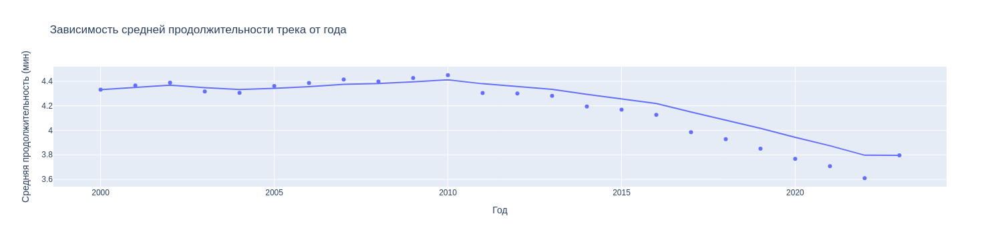

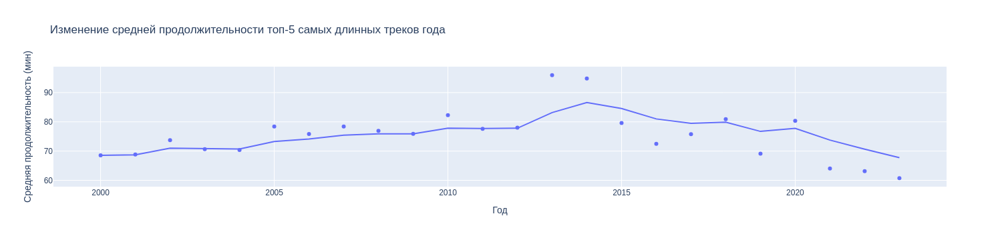

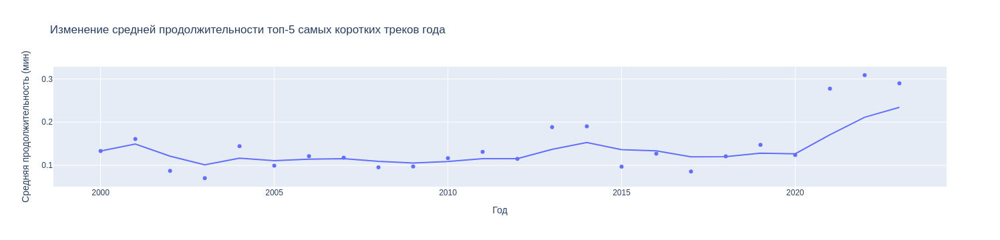

In [15]:
# 1. Зависимость средней продолжительности трека от года
df['duration_ms'] = df['duration_ms'] / 1000 / 60  # Перевод миллисекунд в минуты
df = df.rename(columns={'duration_ms': 'duration_min'})
df_mean_duration = df.groupby('year')['duration_min'].mean().reset_index()

fig1 = px.scatter(df_mean_duration, x="year", y="duration_min",
                  title="Зависимость средней продолжительности трека от года",
                  labels={"year": "Год", "duration_min": "Средняя продолжительность (мин)"},
                  trendline="ewm",
                  trendline_options=dict(halflife=2))
fig1.show()

# 2. Изменение средней продолжительности топ-5 самых длинных треков года
df_top5_long = df.groupby('year')['duration_min'].nlargest(5).reset_index()
df_top5_long = df_top5_long.groupby('year')['duration_min'].mean().reset_index()

fig2 = px.scatter(df_top5_long, x="year", y="duration_min",
                  title="Изменение средней продолжительности топ-5 самых длинных треков года",
                  labels={"year": "Год", "duration_min": "Средняя продолжительность (мин)"},
                  trendline="ewm",
                  trendline_options=dict(halflife=2))
fig2.show()

# 3. Изменение средней продолжительности топ-5 самых коротких треков года
df_top5_short = df.groupby('year')['duration_min'].nsmallest(5).reset_index()
df_top5_short = df_top5_short.groupby('year')['duration_min'].mean().reset_index()

fig3 = px.scatter(df_top5_short, x="year", y="duration_min",
                  title="Изменение средней продолжительности топ-5 самых коротких треков года",
                  labels={"year": "Год", "duration_min": "Средняя продолжительность (мин)"},
                  trendline="ewm",
                  trendline_options=dict(halflife=2))
fig3.show()

### 3. Как менялись популярные жанры от 2000 от 2023? 

**Результат**: Код, реализующий график:
- 3 самых популярных по среднему значению жанра каждого года, с подписью значений

График должен иметь название, подписанные оси и подпись значений

**Дополнительно**: Текстовый ответ, какие жанры оказывались в топ-3 чаще всего.

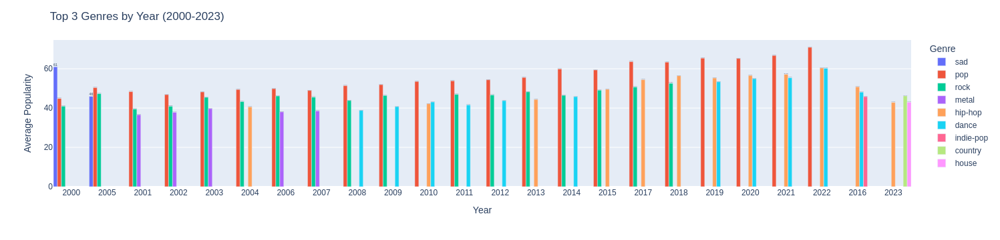

Top 3 Genres Frequency:
genre
pop          22
rock         17
hip-hop      12
dance        11
metal         5
sad           2
indie-pop     1
country       1
house         1
Name: count, dtype: int64


In [17]:
def top_3_genre(year_df):
    genres = year_df.groupby('genre')['popularity'].mean().nlargest(3)
    return genres.to_frame(name='popularity').reset_index()

top_genres_by_year = df.groupby('year').apply(top_3_genre, include_groups=False).reset_index()

# Create the bar chart
fig = px.bar(top_genres_by_year, 
             x='year', 
             y='popularity', 
             color='genre', 
             barmode='group',
             text='popularity')

# Customize the layout
fig.update_layout(
    title="Top 3 Genres by Year (2000-2023)",
    xaxis_title="Year",
    yaxis_title="Average Popularity",
    legend_title="Genre",
    xaxis_type='category',
    xaxis_tickmode='linear',
    bargap=0,
    bargroupgap=0,
    xaxis_dtick=1
)

# Show the figure
fig.show()

# Analyze frequent top 3 genres
genre_counts = top_genres_by_year['genre'].value_counts()
print(f"Top 3 Genres Frequency:\n{genre_counts}")

### 4. Как связаны между собой Speechiness, Acousticness и Instrumentalness?

**Результат**: Код, реализующий 2 различных по типу графика. Выбранные графики должны наиболее хорошо подходить для описания зависимости между указанными параметрами.

Каждый график должен иметь название, подписанные оси и, при необходимости, легенду.

**Дополнительно**: Текстовый ответ, почему были выбраны именно такие графики.

In [18]:
sample_df = df[['speechiness', 'acousticness', 'instrumentalness']].sample(frac=0.005)  # Sample 0.5% of the data

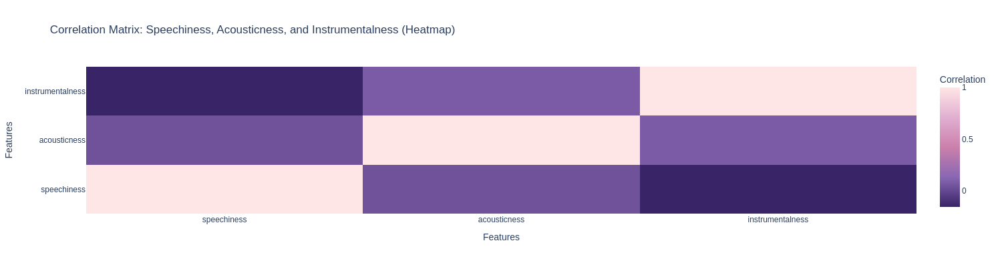

In [19]:
# 1. Heatmap
heatmap_data = sample_df[["speechiness", "acousticness", "instrumentalness"]].corr()

# Custom colorscale
my_colorscale = [
    [0, "#392467"],
    [0.25, "#8967B3"],
    [0.5, "#CB80AB"],
    [0.75, "#E1AFD1"],
    [1, "#FFE6E6"]
]
fig_heatmap = go.Figure(data=go.Heatmap(
    z=heatmap_data.values,
    x=heatmap_data.columns,
    y=heatmap_data.index,
    colorscale=my_colorscale,
    colorbar=dict(title="Correlation"),
))
fig_heatmap.update_layout(
    title="Correlation Matrix: Speechiness, Acousticness, and Instrumentalness (Heatmap)",
    xaxis_title="Features",
    yaxis_title="Features",
    height=400,
    width=400,
)
fig_heatmap.show()
# 2. Scatter Plot 3D
fig = go.Figure(data=[go.Scatter3d(
    x=sample_df['speechiness'],
    y=sample_df['acousticness'],
    z=sample_df['instrumentalness'],
    mode='markers',
    marker=dict(
        size=3,
        color=sample_df['instrumentalness'],  # Color by instrumentalness
        # Define a colormap using a list of tuples (value, color)
        colorscale=[
            [0, "#ADD899"],  # Lowest instrumentalness
            [0.5, "#F075AA"],  # Middle instrumentalness
            [1, "#FFDE95"]  # Highest instrumentalness
        ],
        opacity=0.8
    )
)])

fig.update_layout(
    title="Relationship between Speechiness, Acousticness, and Instrumentalness (3D Scatter Plot)",
    scene=dict(
        xaxis_title="Speechiness",
        yaxis_title="Acousticness",
        zaxis_title="Instrumentalness"
    ),
    height=800,
    width=800,
)

fig.show()

Корреляционная матрица была выбрана для предоставления краткого представления о корреляциях, а 3D-диаграмма предлагает динамичный и интерактивный способ исследования взаимосвязей между тремя признаками

### 5. Какое влияние размер и лад оказывают на популярность в разных жанрах?

**Результат**: Код, реализующий фигуру:

- Жанры для сравнения: deep-house, funk, forro, dancehall, house.
- Точечный график для каждого жанра, отражающий среднюю популярность в зависимости от размера (time_signature) и лада (mode).

Фигура должна иметь название и легенду, каждый график имеет подписанные оси и название.

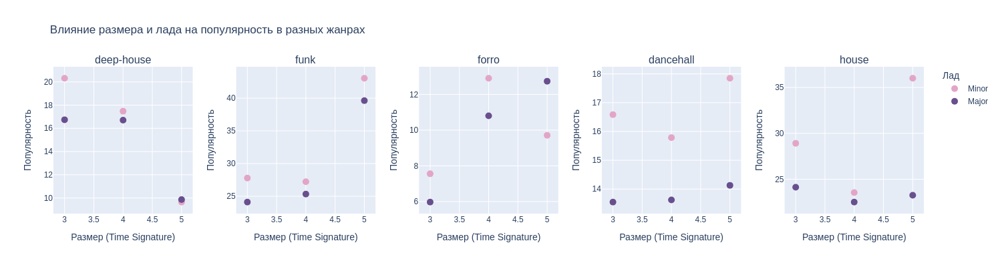

In [20]:
genres_to_compare = ['deep-house', 'funk', 'forro', 'dancehall', 'house']

fig = make_subplots(rows=1, cols=len(genres_to_compare),
                   subplot_titles=genres_to_compare,
                   shared_xaxes=False,
                   shared_yaxes=False,
                   horizontal_spacing=0.05)

minor_trace = go.Scatter(x=[None], y=[None],mode='markers', marker=dict(size=10,color='#E3A5C7'),name="Minor", showlegend=True)
major_trace = go.Scatter(  x=[None], y=[None], mode='markers', marker=dict(size=10, color='#694F8E', ), name="Major", showlegend=True)
fig.add_trace(minor_trace)
fig.add_trace(major_trace)

for i, genre in enumerate(genres_to_compare):
    genre_df = df[df['genre'] == genre] # Filter the DataFrame for the current genre
    avg_popularity = genre_df.groupby(['time_signature', 'mode'])['popularity'].mean().reset_index()

    # Get data for minor and major
    minor_data = avg_popularity[avg_popularity['mode'] == 0]
    major_data = avg_popularity[avg_popularity['mode'] == 1]

    fig.add_trace(go.Scatter(
        x=minor_data['time_signature'],
        y=minor_data['popularity'],
        mode='markers',
        marker=dict(
            size=10,
            color='#E3A5C7',
        ),
        showlegend=False
    ), row=1, col=i+1)

    fig.add_trace(go.Scatter(
        x=major_data['time_signature'],
        y=major_data['popularity'],
        mode='markers',
        marker=dict(
            size=10,
            color='#694F8E',
        ),
        showlegend=False
    ), row=1, col=i+1)

    fig.layout.update({
        f'xaxis{i+1}': {'title': 'Размер (Time Signature)'},
        f'yaxis{i+1}': {'title': 'Популярность'}
    })

fig.update_layout(
    title="Влияние размера и лада на популярность в разных жанрах",
    legend_title="Лад",
    showlegend=True,
    width=1200,
    height=400,
)

fig.show()

### 6. Как выглядят нормальные распределения, построенные для темпа по уникальным значениям размера трека?
**Результат**: Код, реализующий графики распределения темпа (tempo) для всех уникальных значений размера трека (time_signature).

Фигура должна иметь название и легенду. Распределения должны быть построены либо на одном графике, либо на нескольких графиках, но в рамках одной фигуры.

**Дополнительно**: Код с ответом на вопрос, какие параметры (среднее и разброс) для нормальных распределений темпа для размера трека.

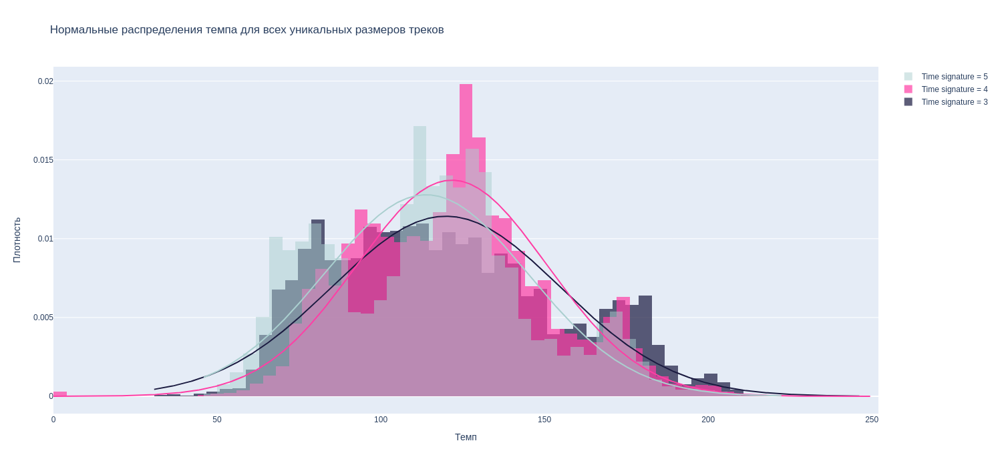

Time signature: 3, Среднее: 119.91, Разброс: 34.93
Time signature: 4, Среднее: 121.71, Разброс: 29.10
Time signature: 5, Среднее: 113.83, Разброс: 31.20


In [21]:
unique_time_signatures = df['time_signature'].unique()

hist_data = []
group_labels = []

for time_signature in unique_time_signatures:
    df_temp = df[df['time_signature'] == time_signature]
    hist_data.append(df_temp['tempo'].values)
    group_labels.append(f'Time signature = {time_signature}')

colors = ['#1A1A40', '#FF3EA5', '#AACFCF']  

fig = ff.create_distplot(hist_data, group_labels,
                        bin_size=[4, 4, 4],
                        curve_type="normal", 
                        show_curve=True,
                        show_hist=True,
                        show_rug=False,
                        colors=colors
                       )

fig.data[1].update(opacity=0.7) 
fig.data[2].update(opacity=0.5) 
    
fig.update_layout(
    title='Нормальные распределения темпа для всех уникальных размеров треков',
    xaxis_title='Темп',
    yaxis_title='Плотность',
    height=700,
    width=800,
)
fig.show()

# Calculate and print mean and standard deviation for each time signature
for i, time_signature in enumerate(unique_time_signatures):
    mean = np.mean(hist_data[i])
    std = np.std(hist_data[i])
    print(f'Time signature: {time_signature}, Среднее: {mean:.2f}, Разброс: {std:.2f}')

### 7. Проанализируйте популярность одного артиста (группы) с 10-100 треками на Ваш выбор. 

**Результат**: Код, реализующий следующие графики:

- График, отражающий динамику суммарной популярности артиста год от года. Укажите стрелками с подписями, благодаря каким треками артист был на пике и на дне популярности.
- Сопоставьте признаки для этих двух треков, в виде графиков на Ваш выбор. Укажите, какие из признаков вероятнее всего оказали наибольшее влияние на популярность выбранных треков.

Графики должны находится в одной фигуре, имеющей название. Каждый график должен иметь название, подписанные оси и, при необходимости, легенду.

In [22]:
artist_counts = df.groupby('artist_name')['track_name'].nunique().reset_index(name='track_count')
filtered_artists = artist_counts[(artist_counts['track_count'] >= 10) & (artist_counts['track_count'] <= 100)]
sorted_artists = filtered_artists.sort_values('track_count', ascending=False)

artist_name = sorted_artists.iloc[11]['artist_name']
print(f"The 4th artist (with track count between 10 and 100) is: {artist_name}")

The 4th artist (with track count between 10 and 100) is: Radical Redemption


In [23]:
artist_df = df[df['artist_name'] == artist_name]
yearly_popularity = artist_df.groupby('year')['popularity'].sum().reset_index()

peak_tracks = artist_df.groupby('year').apply(lambda group: group.groupby('track_name')['popularity'].sum().idxmax(), include_groups=False).reset_index(name='best_track')
bottom_tracks = artist_df.groupby('year').apply(lambda group: group.groupby('track_name')['popularity'].sum().idxmin(), include_groups=False).reset_index(name='worst_track')

yearly_popularity = pd.merge(yearly_popularity, peak_tracks, on='year', how='left')
yearly_popularity = pd.merge(yearly_popularity, bottom_tracks, on='year', how='left')

peak_track = yearly_popularity.loc[yearly_popularity['popularity'].idxmax(), "best_track"]
bottom_track = yearly_popularity.loc[yearly_popularity['popularity'].idxmin(), "worst_track"]

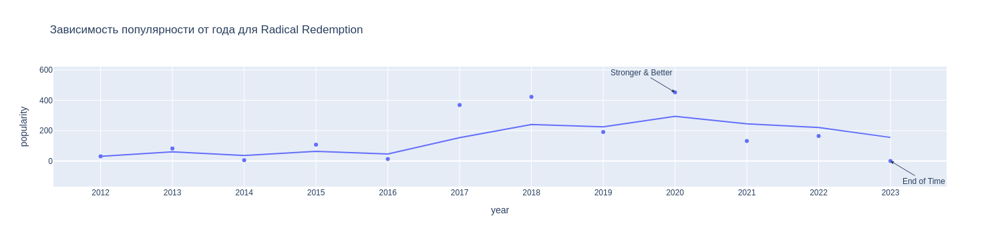

In [24]:
# График, отражающий динамику суммарной популярности артиста год от года
fig = px.scatter(yearly_popularity,
                 x="year",
                 y="popularity",
                 title=f'Зависимость популярности от года для {artist_name}',
                 trendline="ewm",
                 trendline_options=dict(halflife=2))

# Annotate the best song
fig.add_annotation(
    x=yearly_popularity.loc[yearly_popularity['popularity'].idxmax(), 'year'],
    y=yearly_popularity['popularity'].max(),
    xref='x',
    yref='y',
    text=peak_track,
    showarrow=True,
    arrowhead=2,
    ax=-50,
    ay=-30,
    font=dict(size=12),
)

# Annotate the worst song
fig.add_annotation(
    x=yearly_popularity.loc[yearly_popularity['popularity'].idxmin(), 'year'],
    y=yearly_popularity['popularity'].min(),
    xref='x',
    yref='y',
    text=bottom_track,
    showarrow=True,
    arrowhead=2,
    ax=50,
    ay=30,
    font=dict(size=12),
)

# Update the layout
fig.update_layout(
    xaxis_dtick=1
)

fig.show()

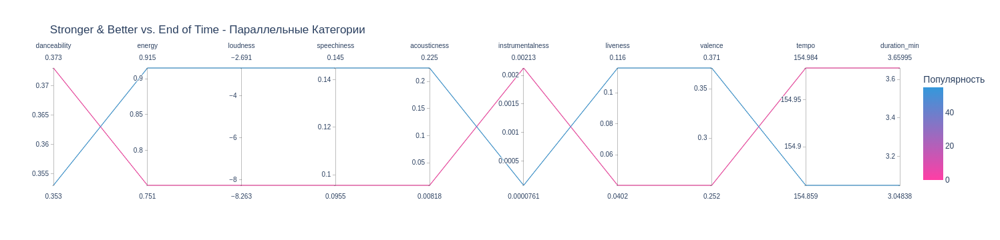

In [25]:
df_tracks = artist_df[(artist_df['track_name'] == peak_track) | (artist_df['track_name'] == bottom_track)]
columns = ['danceability', 'energy', 'loudness', 'speechiness', 'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo', 'duration_min']
custom_colors = ['#FF3EA5', '#3498DB']

# Create the parallel coordinates plot
fig = px.parallel_coordinates(
    df_tracks,
    dimensions=columns,
    color="popularity",
    color_continuous_scale=custom_colors, 
    title=f"{peak_track} vs. {bottom_track} - Параллельные Категории",
    labels={"popularity": "Популярность"}
)

fig.show()

In [26]:
df_tracks = df_tracks[columns].astype(float)  # Convert columns to numeric
percentage_differences = {}
for column in columns:
    difference = abs(df_tracks[column].iloc[0] - df_tracks[column].iloc[1])
    percentage = (difference / (abs(df_tracks[column].iloc[0] + df_tracks[column].iloc[1]) / 2)) * 100
    percentage_differences[column] = percentage

# Sort the differences in descending order
sorted_differences = dict(sorted(percentage_differences.items(), key=lambda item: item[1], reverse=True))

print("Possible features affected to popularity in descending order with percentage difference:")
for feature, percentage in sorted_differences.items():
    print(f"{feature}: {percentage:.2f}%")

Possible features affected to popularity in descending order with percentage difference:
instrumentalness: 186.20%
acousticness: 185.97%
loudness: 101.73%
liveness: 97.06%
speechiness: 41.16%
valence: 38.20%
energy: 19.69%
duration_min: 18.23%
danceability: 5.51%
tempo: 0.08%
